<a href="https://colab.research.google.com/github/semadenipaul/cse380-notebooks/blob/master/Copy_of_10_2_Ponder_and_Prove_Spanning_Trees.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Ponder and Prove Spanning Trees
## Due: Saturday, 13 March 2021, 11:59 pm

In [ ]:
!pip install graphviz
!pip install networkx

In [ ]:
import os
os.path.abspath(os.getcwd())

'/content'

## The Goal

The goal of this assignment is to investigate spanning trees of graphs.

Here is the example spanning tree you saw in your DPC:

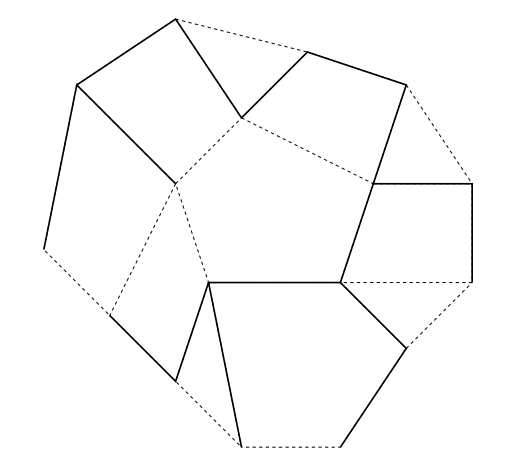

Wikipedia has a [Spanning Tree](https://en.wikipedia.org/wiki/Spanning_tree) page with useful information.

## Algorithm to Find a Spanning Tree

In five pseudocode steps:
1. Start with the "frontier" being a list of size one --- containing just the first node.
2. Pick a link connected to a node in the frontier that does not create a cycle --- that is, the other (destination) node of the link is not already in the frontier.
3. Add that destination node to the frontier unless already there.
4. Add the picked link to the spanning-tree.
5. Repeat steps 2-4 until all nodes are in the frontier.

## What to Create

1. A graph representation --- a way to represent both nodes and links.
2. A function that takes a graph and returns a list of its nodes.
3. A function that takes a graph and returns a list of its links.
4. A function that takes a graph and returns an adjacency list of nodes and links.
5. A function that takes a graph and a node and returns a list of adjacent nodes to that node.

In [ ]:
graph = {'a' : ['b', 'c'], 'b' : ['a', 'd'], 'c' : ['a', 'd'], 'd' : ['b', 'c']}

In [ ]:
def get_nodes(graph):
  return [*graph]

In [ ]:
def get_links(graph):
  frozen = set([frozenset(tuple(set([k, v]))) for k in get_nodes(graph) for v in graph[k]])
  return [tuple(x) for x in frozen]

In [ ]:
def adj_list(graph):
  return graph 
#[[k,v] for k,v in graph.items()]

In [ ]:
def get_adj_nodes(graph, node):
  return graph[node]

In [ ]:
print(get_nodes(graph))

['a', 'b', 'c', 'd']


In [ ]:
print(get_links(graph))

[('a', 'b'), ('d', 'b'), ('a', 'c'), ('c', 'd')]


In [ ]:
print(adj_list(graph))

{'a': ['b', 'c'], 'b': ['a', 'd'], 'c': ['a', 'd'], 'd': ['b', 'c']}


In [ ]:
print(get_adj_nodes(graph, 'a'))

['b', 'c']


In [ ]:
new_graph = {'a' : ['c', 'b', 'g'], 'b' : ['a', 'f', 'h'], 'c' : ['d', 'e', 'a'], 'd' : ['c'], 'e' : ['c', 'f', 'g'], 'f' : ['b', 'e', 'h'], 'g' : ['a', 'h', 'e'], 'h' : ['f', 'b', 'g']}
ladder_graph = {1 : [2, 5], 2 : [1, 6, 3], 3 : [2, 7, 4], 4 : [3, 8], 5 : [1, 6], 6 : [5, 2, 7], 7 : [6, 3, 8], 8 : [7, 4]}

In [ ]:
def gen_spanning_tree(graph, root=None):
  # Step 1
  tree = []
  frontier = []
  if not root:
    root = get_nodes(graph)[0]
  frontier = [root]
  tree = gen_spanning_tree_rec(graph, frontier)
  return build_tree(tree)

def gen_spanning_tree_rec(graph, frontier, tree=[]):
  if set(frontier) == set(get_nodes(graph)):
    return tree
  possible = list(filter(lambda n: (n[1] not in frontier and n[0] in frontier) or (n[0] not in frontier and n[1] in frontier), get_links(graph)))
  return gen_spanning_tree_rec(graph, frontier + [possible[0][0] if possible[0][0] not in frontier else possible[0][1]], tree + [possible[0]])

In [ ]:
import networkx as nx 

def gen_random_graph(n, p):
  G= nx.erdos_renyi_graph(n, p)
  return list(G.edges)

In [ ]:
gen_random_graph(6, .5)

[(0, 1), (0, 3), (1, 2), (1, 3), (1, 5), (2, 4), (4, 5)]

In [ ]:
from graphviz import Graph
from IPython.display import Image, display

# The only thing not functional here is graphviz
def display_graph(graph):
  links = get_links(graph)
  nodes = get_nodes(graph)
  dot = Graph(format='png')
  map(lambda n: dot.node(str(n)), nodes)
  for pair in links:
    dot.edge(str(pair[0]), str(pair[1]))
  #e = list(map(lambda pair: str(pair[0]) + str(pair[1]), links))
  #dot.edges(e)
  dot.render('test-output/graph', view=True)
  display(Image('/content/test-output/graph.png'))

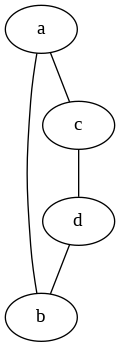

In [ ]:
display_graph(graph)

In [ ]:

def build_tree(pairs):
  nodes = list(set([x for pair in range(len(pairs)) for x in pairs[pair]]))
  prelim_tree = {key:list(set([links[1] if (links[0] == key and links[1] != key) else links[0] if (links[0] != key and links[1] == key) else '' for links in pairs])) for key in nodes}
  tree = {key:list(filter(lambda x : x != '', prelim_tree[key])) for key in prelim_tree}
  return tree
  

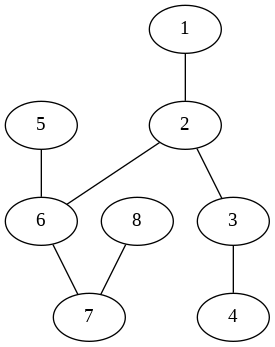

In [ ]:
l = [(1, 2), (2, 6), (6, 7), (5, 6), (2, 3), (8, 7), (3, 4)]
new = build_tree(l)
display_graph(new)

## Test Your Code

You will need several different types of graphs (including ladder graphs) with which to test your algorithm.


See the self-assessment for specifics.

In [ ]:
# 3 of my own Graphs:
g_1 = build_tree(gen_random_graph(40, 0.7))
g_2 = build_tree(gen_random_graph(23, 1.7))
g_3 = build_tree(gen_random_graph(34, 2.0))

# Graph from the top of the page
graph_top = {'a' : ['c', 'b', 'd'], 'b' : ['a', 'e'], 'c' : ['a', 'f', 'g'], 'd' : ['a', 'e', 'f', 'i' ], 'e' : ['b', 'd', 'h'], 'f' : ['d', 'c', 'g', 'j'], 'g' : ['c', 'f', 'k'], 'h' : ['e', 'i', 'q'], 'i' : ['d', 'h', 'o', 'q'], 'j' : ['f', 'l', 'o', 'k'], 'k' : ['g', 'l', 'j'], 'l' : ['k', 'm', 'j'], 'm' : ['l', 'o', 'n'], 'n' : ['m', 'o', 'p'], 'o' : ['j', 'i', 'n', 'm'], 'p' : ['n', 'q'], 'q': ['p', 'i', 'h']}
# Ladder Graphs:
ladder_graph_2 ={1 : [2, 3], 2 : [1, 4], 3 : [1, 4], 4 : [3, 2]}
ladder_graph_3 = {1 : [2, 4], 2 : [1, 5, 3], 3 : [2, 6], 4 : [1, 5], 5 : [4, 2, 6], 6 : [5, 3]}
ladder_graph_4 = {1 : [2, 5], 2 : [1, 6, 3], 3 : [2, 7, 4], 4 : [3, 8], 5 : [1, 6], 6 : [5, 2, 7], 7 : [6, 3, 8], 8 : [7, 4]}
ladder_graph_5 = {1 : [2, 6], 2 : [1, 3, 7], 3 : [2, 4, 8], 4 : [3, 9, 5], 5 : [4, 10], 6 : [1, 7], 7 : [6, 2, 8], 8 : [7, 3, 9], 9 : [8, 4, 10], 10 : [9, 5]}

### Ladder Graphs

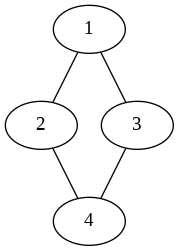

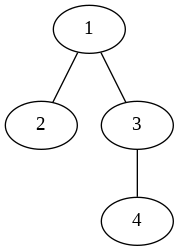

In [ ]:
display_graph(ladder_graph_2)
tree = gen_spanning_tree(ladder_graph_2)
display_graph(tree)

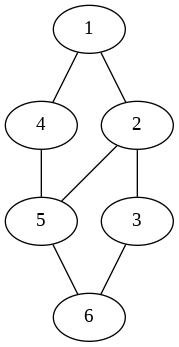

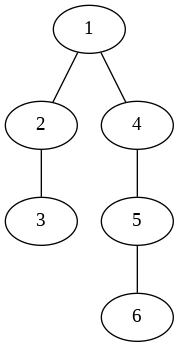

In [ ]:
display_graph(ladder_graph_3)
tree = gen_spanning_tree(ladder_graph_3)
display_graph(tree)

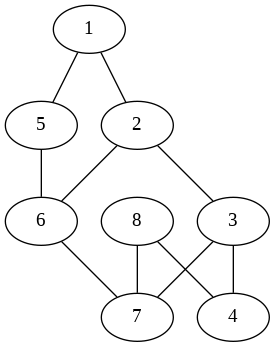

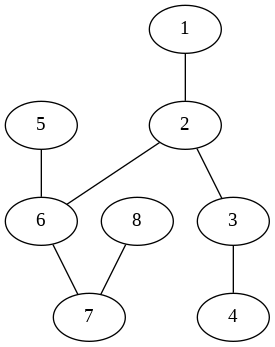

In [ ]:
display_graph(ladder_graph_4)
tree = gen_spanning_tree(ladder_graph_4)
display_graph(tree)

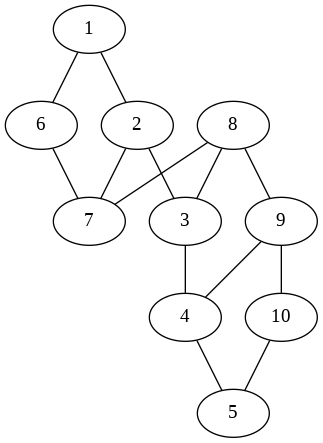

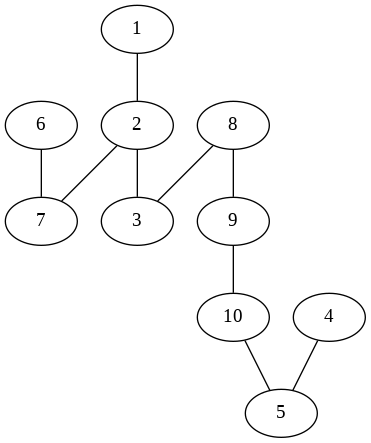

In [ ]:
display_graph(ladder_graph_5)
tree = gen_spanning_tree(ladder_graph_5)
display_graph(tree)

### Example Graph

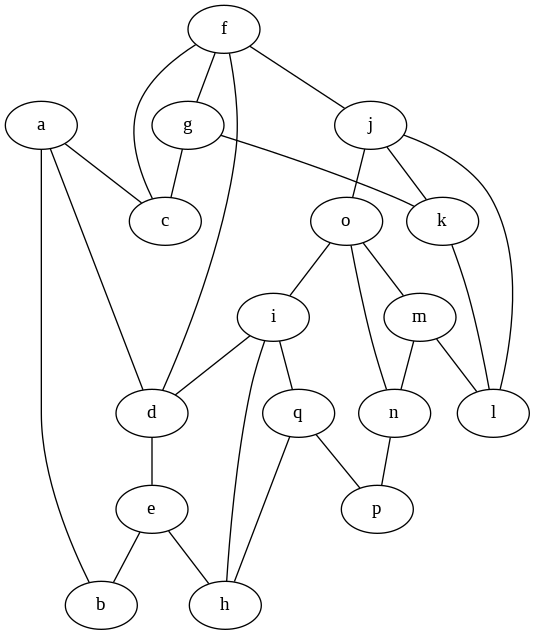

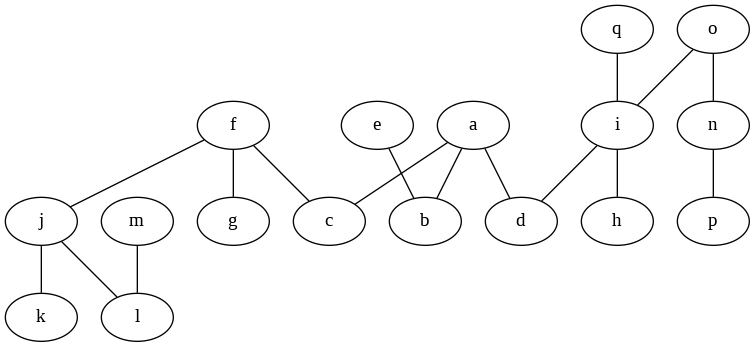

In [ ]:
display_graph(graph_top)
tree = gen_spanning_tree(graph_top)
display_graph(tree)

### 3 of my own graphs:

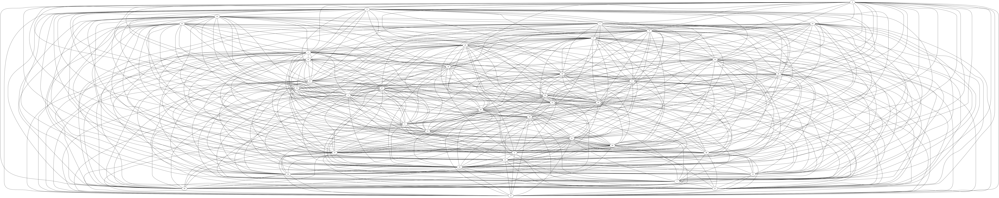

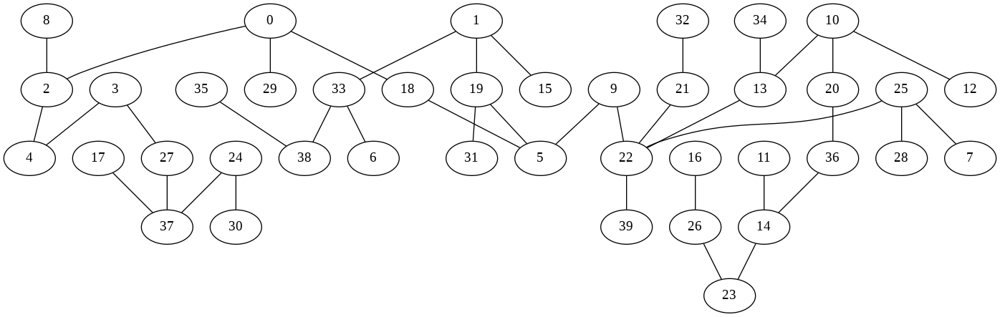

In [ ]:
display_graph(g_1)
tree = gen_spanning_tree(g_1)
display_graph(tree)

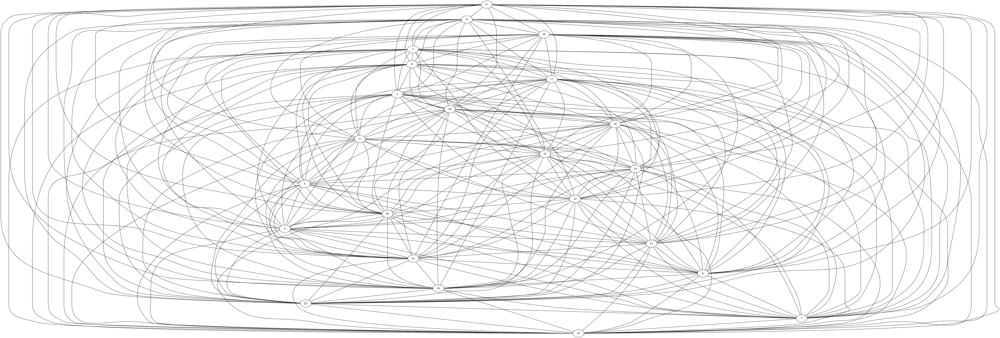

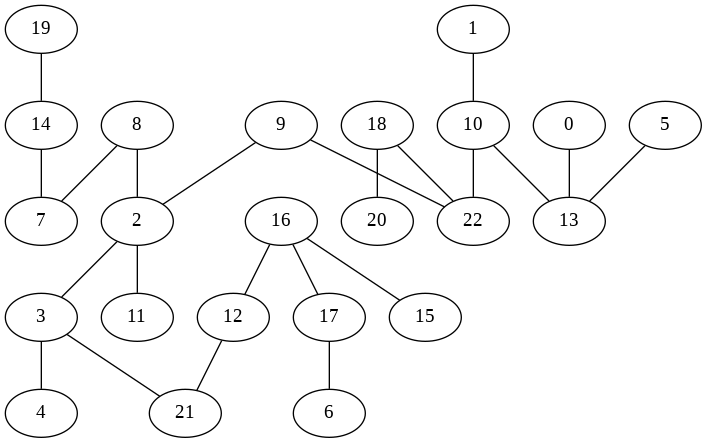

In [ ]:
display_graph(g_2)
tree = gen_spanning_tree(g_2)
display_graph(tree)

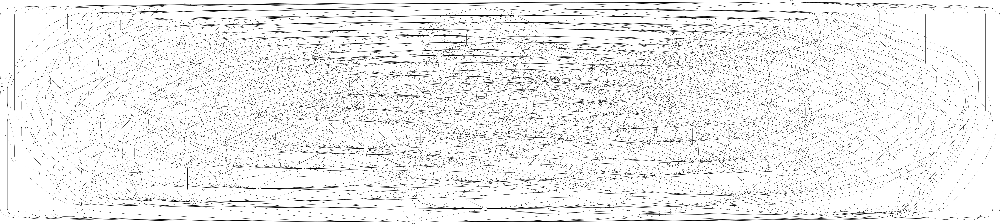

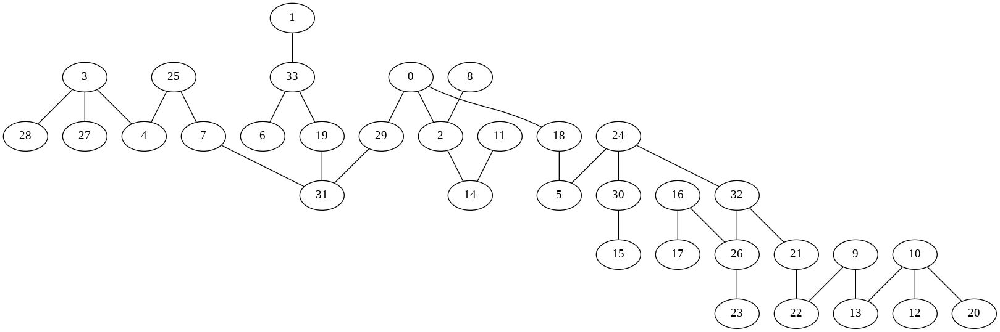

In [ ]:
display_graph(g_3)
tree = gen_spanning_tree(g_3)
display_graph(tree)

# My Report on What I Did and What I Learned

## Fun


While the basic problem of finding a spanning tree was not overly complicated, my group and I decided to make everything functional. This added a whole new challenge and was fun to work together to figure it out. We worked hard at making everything purely functional, and we were proud of the results. Functional programming is fun for me because I can take problems that would normally be trivial to solve and adds a new layer of depth that requires more effort and creativity to come up with an answer.

## New

The biggest thing I learned was what a spanning tree was, to be honest. I think it is useful to be able to turn any undirected graph into a tree using the spanning tree algorithm. I also learned a lot about functional programming. I learned that python has a * operator that unpacks keys from a dictionary. This discovery made finding the nodes in our dictionary graph trivial.

## Meaningful


The most meaningful thing I learned while solving this problem was the importance of looking at the big picture of a problem and then breaking it down into its simplest pieces. I also learned more about graphs and what a spanning tree is. I know that the ability to find spanning trees from graphs will be a useful skill that I can build upon as I dive deeper into graph theory throughout my life.

## Other

I collaborated with Brayden Whitlock, Matthew Reed, and Paul Samedani. We all worked together to understand the problem and write the code. This makes it difficult to locate specific contributions.<br><br>

The most important connection I made from this p&p was the subset relationship that trees have to graphs. The ability to utilize that subset relationship and make a tree from any undirected graph (assuming it does not have any isolated nodes) is a powerful mathematical application for both types of structures. It makes me wonder if there would be a use in constructing graphs from trees.

## Above and Beyond

My group and I wrote all our code in a pure functional style, with the excpetion of using outside OOP based libraries. We also were able to randomly generate graphs for our 3 tests.

# What is True?
Click on each warranted checkbox to toggle it to True (or back to False). 

NOTE: *This only works in Colab. If you run it in some other Jupyter notebook client/server environment you may have to change False to True (or vice versa) manually.*

This self-assessment is subject to revision by a grader.

In [ ]:
#@markdown ## What is True about what I did?
#@markdown ### I had fun.
cb00 = True #@param {type:'boolean'}
#@markdown ### I learned something new.
cb01 = True #@param {type:'boolean'}
#@markdown ### I achieved something meaningful, or something I can build upon at a later time.
cb02 = True #@param {type:'boolean'}
#@markdown ## What is True about my report?
#@markdown ### I wrote a sufficient number of well-written sentences.
cb03 = True #@param {type:'boolean'}
#@markdown ### My report is free of mechanical infelicities.
cb04 = True #@param {type:'boolean'}
#@markdown ### I used Grammarly (or something better described in my report) to check for MIs.
cb05 = True #@param {type:'boolean'}
#@markdown ### I reported on any connections I found between these problems and something I already know. 
cb06 = True #@param {type:'boolean'}
#@markdown ### I reported who were and what contribution each of my collaborators made.
cb07 = True #@param {type:'boolean'}
#@markdown ## What is True about my code?
#@markdown ### I created code to represent a graph as (at a bare minimum) a set of nodes and a set of links.
cb08 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns a list of its nodes.
cb09 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns a list of its links.
cb10 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns an adjacency list of nodes and links.
cb11 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and a node and returns a list of adjacent nodes to that node.
cb12 = True #@param {type:'boolean'}
#@markdown ### I correctly implemented the spanning tree algorithm.
cb13 = True #@param {type:'boolean'}
#@markdown ## What is true about my testing?
#@markdown ### I created a ladder graph with 2 rungs and tested my code on it.
cb14 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 3 rungs and tested my code on it.
cb15 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 4 rungs and tested my code on it.
cb16 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 5 rungs and tested my code on it.
cb17 = True #@param {type:'boolean'}
#@markdown ### I created a graph from the example at the top of this notebook and tested my code on it.
cb18 = True #@param {type:'boolean'}
#@markdown ### I created three larger graphs (each with more than 20 nodes and more than 40 links) of my own devising and tested my code on it.
cb19 = False #@param {type:'boolean'}

## DO NOT CHANGE ANYTHING IN THE NEXT CODE CELL!!
### Delete this cell and the following ones before submitting your work.

In [ ]:
points_for_what_I_did = [5]*3
points_for_my_report = [8]*5
points_for_my_code = [5]*6
points_for_my_testing = [2]*4 + [3,4]
points = points_for_what_I_did + points_for_my_report + points_for_my_code + points_for_my_testing
# cb is short for checkbox
total = sum(map(lambda n, p: p if eval(f'cb{n:02}') else 0,
                range(len(points)), points))             
total

0

# For graders

In [ ]:
#@markdown ---
number_of_MIs_found = 0 #@param {type: 'slider', min: 0, max: 5}
#@markdown ---
